# LSTM Rentals One Station

### LIBRERIAS

In [108]:
import pandas as pd
import math
import numpy as np

from matplotlib import pyplot as plt

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, TimeDistributed
from tensorflow.keras.losses import mean_squared_error

### CARGA DE COMPLETE RENTALS DF & WEATHER DF

In [2]:
completeRentalsDf = pd.read_csv('../data/completeData/rentals/completeRentalsDf.csv')

In [109]:
completeRentalsDf = pd.read_csv('../data/completeData/rentals/completeRentalsDf_LOG1P.csv')

In [110]:
completeRentalsDf['Date'] = pd.to_datetime(completeRentalsDf['Date'])
completeRentalsDf.set_index('Date', inplace=True)

In [111]:
completeWeatherDf = pd.read_csv('../data/completeData/weather/completeWeatherDf.csv')

In [112]:
def getTrainValidationTestStationT24(trainDays, validationDays, station, completeRentalsDf):
    X = completeRentalsDf[[station]].values.reshape(-1,24)
    Y = np.delete(X, 0, 0)
    X = np.delete(X, len(X)-1, 0)

    X_train, Y_train = X[0:trainDays], Y[0:trainDays]
    X_validation, Y_validation = X[trainDays:trainDays+validationDays], Y[trainDays:trainDays+validationDays]
    X_test , Y_test = X[trainDays+validationDays:X.shape[0]], Y[trainDays+validationDays:Y.shape[0]]

    print("Shape del dataframe 'X_train' --> {} // 'X_validation --> {} //  X_test --> {}".format(X_train.shape,X_validation.shape, X_test.shape))
    print("Shape del dataframe 'Y_train' --> {} // 'Y_validation --> {} // Y_test --> {}".format(Y_train.shape, Y_validation.shape, Y_test.shape))
    return X_train, X_validation, X_test, Y_train, Y_validation, Y_test

def getTrainValidationTestStationT24T48(trainDays, validationDays, station, completeRentalsDf):
    X_24 = np.delete(completeRentalsDf[[station]].values.reshape(-1, 24), 0, 0)
    X_48 = np.delete(completeRentalsDf[[station]].values.reshape(-1, 24), len(X_24)-1, 0)
    X = np.delete( np.append( X_48, X_24, axis=1).reshape(-1,2, 24), len(X_24)-1, 0 )

    X_transposed = np.empty((len(X), 24, 2))
    for i in range(0, len(X)):
        X_transposed[i] = X[i].transpose()

    X = X_transposed
    Y = np.delete(completeRentalsDf[[station]].values.reshape(-1, 24), [0,1], 0)

    X_train, Y_train = X[0:trainDays], Y[0:trainDays]
    X_validation, Y_validation = X[trainDays:trainDays+validationDays], Y[trainDays:trainDays+validationDays]
    X_test , Y_test = X[trainDays+validationDays:X.shape[0]], Y[trainDays+validationDays:Y.shape[0]]

    print("Shape del dataframe 'X_train' --> {} // 'X_validation --> {} //  X_test --> {}".format(X_train.shape,X_validation.shape, X_test.shape))
    print("Shape del dataframe 'Y_train' --> {} // 'Y_validation --> {} // Y_test --> {}".format(Y_train.shape, Y_validation.shape, Y_test.shape))
    return X_train, X_validation, X_test, Y_train, Y_validation, Y_test

def getTrainValidationTestStationT24T48T168(trainDays, validationDays, station, completeRentalsDf):
    X_24 = np.delete(completeRentalsDf[[station]].values.reshape(-1, 24), [range(0, 6)], 0)
    X_48 = completeRentalsDf[[station]].values.reshape(-1, 24)
    X_48 = np.delete(X_48, [range(0, 5)], 0)
    X_48 = np.delete(X_48, len(X_48)-1, 0)
    X_168 = completeRentalsDf[[station]].values.reshape(-1, 24)
    X_168 = np.delete(X_168, [[len(X_168)-i for i in range(1, 7)]], 0)

    X = np.append( np.append( X_168, X_48, axis=1), X_24, axis = 1).reshape(-1,3, 24)
    X = np.delete(X, len(X)-1, 0)
    X_transposed = np.empty((len(X), 24, 3))
    for i in range(0, len(X)):
        X_transposed[i] = X[i].transpose()

    X = X_transposed
    Y = np.delete(X_24, 0, 0)

    X_train, Y_train = X[0:trainDays], Y[0:trainDays]
    X_validation, Y_validation = X[trainDays:trainDays+validationDays], Y[trainDays:trainDays+validationDays]
    X_test , Y_test = X[trainDays+validationDays:X.shape[0]], Y[trainDays+validationDays:Y.shape[0]]

    print("Shape del dataframe 'X_train' --> {} // 'X_validation --> {} //  X_test --> {}".format(X_train.shape,X_validation.shape, X_test.shape))
    print("Shape del dataframe 'Y_train' --> {} // 'Y_validation --> {} // Y_test --> {}".format(Y_train.shape, Y_validation.shape, Y_test.shape))
    return X_train, X_validation, X_test, Y_train, Y_validation, Y_test

def getTrainValidationTestStationT24T48T144T168(trainDays, validationDays, station, completeRentalsDf):
    X_24 = np.delete(completeRentalsDf[[station]].values.reshape(-1, 24), [range(0, 6)], 0)
    X_48 = completeRentalsDf[[station]].values.reshape(-1, 24)
    X_48 = np.delete(X_48, [range(0, 5)], 0)
    X_48 = np.delete(X_48, len(X_48)-1, 0)
    X_144 = completeRentalsDf[[station]].values.reshape(-1, 24)
    X_144 = np.delete(X_144, [[len(X_144)-i for i in range(1, 6)]], 0)
    X_144 = np.delete(X_144, 0, 0)
    X_168 = completeRentalsDf[[station]].values.reshape(-1, 24)
    X_168 = np.delete(X_168, [[len(X_168)-i for i in range(1, 7)]], 0)

    X = np.append( np.append( X_144, X_48, axis=1), X_24, axis = 1)
    X = np.append(X_168, X, axis=1).reshape(-1,4, 24)
    X = np.delete(X, len(X)-1, 0)
    X_transposed = np.empty((len(X), 24, 4))
    for i in range(0, len(X)):
        X_transposed[i] = X[i].transpose()

    X = X_transposed
    Y = np.delete(X_24, 0, 0)

    X_train, Y_train = X[0:trainDays], Y[0:trainDays]
    X_validation, Y_validation = X[trainDays:trainDays+validationDays], Y[trainDays:trainDays+validationDays]
    X_test , Y_test = X[trainDays+validationDays:X.shape[0]], Y[trainDays+validationDays:Y.shape[0]]

    print("Shape del dataframe 'X_train' --> {} // 'X_validation --> {} //  X_test --> {}".format(X_train.shape,X_validation.shape, X_test.shape))
    print("Shape del dataframe 'Y_train' --> {} // 'Y_validation --> {} // Y_test --> {}".format(Y_train.shape, Y_validation.shape, Y_test.shape))
    return X_train, X_validation, X_test, Y_train, Y_validation, Y_test

def getTrainValidationTestStationT24T48T168_ExogVariables(trainDays, validationDays, station, completeRentalsDf, completeWeatherDf):
    X_24 = np.delete(completeRentalsDf[[station]].values.reshape(-1, 24), [range(0, 6)], 0)
    X_48 = completeRentalsDf[[station]].values.reshape(-1, 24)
    X_48 = np.delete(X_48, [range(0, 5)], 0)
    X_48 = np.delete(X_48, len(X_48)-1, 0)
    X_168 = completeRentalsDf[[station]].values.reshape(-1, 24)
    X_168 = np.delete(X_168, [[len(X_168)-i for i in range(1, 7)]], 0)

    X_temp = np.delete(completeWeatherDf['temp'].values.reshape(-1, 24), [range(0, 7)], 0)
    X_humidity = np.delete(completeWeatherDf['humidity'].values.reshape(-1, 24), [range(0, 7)], 0)

    X = np.append( np.append( X_168, X_48, axis=1), X_24, axis = 1)
    X = np.delete(X, len(X)-1, 0)
    X = np.append( np.append( X_temp, X_humidity, axis=1), X, axis=1).reshape(-1,5, 24)

    X_transposed = np.empty((len(X), 24, 5))
    for i in range(0, len(X)):
        X_transposed[i] = X[i].transpose()

    X = X_transposed
    Y = np.delete(X_24, 0, 0)

    X_train, Y_train = X[0:trainDays], Y[0:trainDays]
    X_validation, Y_validation = X[trainDays:trainDays+validationDays], Y[trainDays:trainDays+validationDays]
    X_test , Y_test = X[trainDays+validationDays:X.shape[0]], Y[trainDays+validationDays:Y.shape[0]]

    print("Shape del dataframe 'X_train' --> {} // 'X_validation --> {} //  X_test --> {}".format(X_train.shape,X_validation.shape, X_test.shape))
    print("Shape del dataframe 'Y_train' --> {} // 'Y_validation --> {} // Y_test --> {}".format(Y_train.shape, Y_validation.shape, Y_test.shape))
    return X_train, X_validation, X_test, Y_train, Y_validation, Y_test

In [113]:
def plotDayPrediction(predictions, Y, day, log1pData):

    data = pd.DataFrame()
    try:
        if log1pData:
            data['prediction'] = np.round(np.expm1(predictions[day]),0)
            data['real'] = np.expm1(Y[day])
        else:
            data['prediction'] = np.round(predictions[day],0)
            data['real'] = Y[day]
    except:
        print("El dia tiene que ser inferior a {}".format(len(Y)) )

    plt.figure(figsize=(12,5))
    plt.xlabel('Prediction of day ' + str(day))

    ax1 = data.prediction.plot(color='red', grid=True, label='Forecast')
    ax2 = data.real.plot(color='blue', grid=True, label='Actual')
    h1, l1 = ax1.get_legend_handles_labels()

    plt.legend(h1, l1, loc=2)
    plt.show()

In [114]:
def log1p_mse_rmse(Y_test, predictions):
    rmse = 0
    mse = 0
    for i in range(0, len(predictions)):
        mse += mean_squared_error(np.expm1(Y_test[i]), np.expm1(predictions[i]))

    mse /= len(predictions)
    rmse += math.sqrt(mse)
    print("MSE = {}, RMSE = {}".format(mse,rmse))

In [115]:
epochs = 10000
batch_size = 4096

### LSTM CON DISTRIBUTED LAYER [MANY TO MANY] t-24h

In [66]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24(4000, 105, '31005', completeRentalsDf)

Shape del dataframe 'X_train' --> (4000, 24) // 'X_validation --> (105, 24) //  X_test --> (105, 24)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (105, 24) // Y_test --> (105, 24)


In [12]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 1), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2496      
_________________________________________________________________
time_distributed (TimeDistri (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,081
Trainable params: 3,081
Non-trainable params: 0
______________________________________________________

In [13]:
with tf.device('/GPU:0'):
    model.fit(X_train.reshape(X_train.shape[0], X_train.shape[1], 1), Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 2s 2s/step - loss: 1.6101 - mae: 0.5547
Epoch 2/10000
1/1 [==============================] - 0s 10ms/step - loss: 1.6077 - mae: 0.5555
Epoch 3/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.6055 - mae: 0.5562
Epoch 4/10000
1/1 [==============================] - 0s 8ms/step - loss: 1.6033 - mae: 0.5569
Epoch 5/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.6011 - mae: 0.5577
Epoch 6/10000
1/1 [==============================] - 0s 11ms/step - loss: 1.5990 - mae: 0.5584
Epoch 7/10000
1/1 [==============================] - 0s 10ms/step - loss: 1.5968 - mae: 0.5592
Epoch 8/10000
1/1 [==============================] - 0s 13ms/step - loss: 1.5946 - mae: 0.5600
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.5924 - mae: 0.5608
Epoch 10/10000
1/1 [==============================] - 0s 11ms/step - loss: 1.5902 - mae: 0.5616
Epoch 11/10000
1/1 [==============================] - 0

In [14]:
score = model.evaluate(X_validation.reshape(X_validation.shape[0], X_validation.shape[1], 1), Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 0.9008414904260101
 Test loss: 0.8115153908729553
 Test mae: 0.5874937772750854


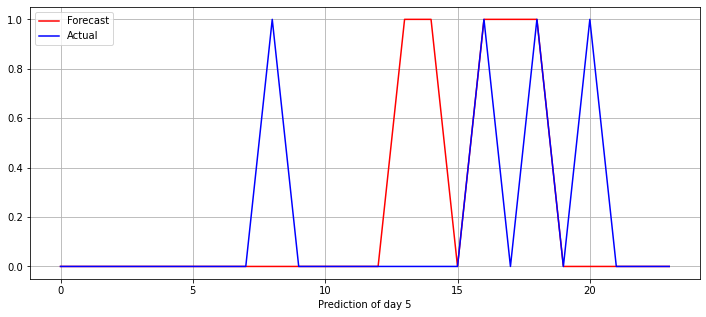

In [15]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1, 24)
plotDayPrediction(predictions, Y_test, 5, False)

#### LOG1P

In [13]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 1), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2496      
_________________________________________________________________
time_distributed_1 (TimeDist (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,081
Trainable params: 3,081
Non-trainable params: 0
____________________________________________________

In [14]:
with tf.device('/GPU:0'):
    model.fit(X_train.reshape(X_train.shape[0], X_train.shape[1], 1), Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 0.2754 - mae: 0.2850
Epoch 2/10000
1/1 [==============================] - 0s 102ms/step - loss: 0.2630 - mae: 0.2889
Epoch 3/10000
1/1 [==============================] - 0s 80ms/step - loss: 0.2528 - mae: 0.2927
Epoch 4/10000
1/1 [==============================] - 0s 9ms/step - loss: 0.2447 - mae: 0.2967
Epoch 5/10000
1/1 [==============================] - 0s 10ms/step - loss: 0.2373 - mae: 0.3006
Epoch 6/10000
1/1 [==============================] - 0s 10ms/step - loss: 0.2305 - mae: 0.3046
Epoch 7/10000
1/1 [==============================] - 0s 10ms/step - loss: 0.2243 - mae: 0.3084
Epoch 8/10000
1/1 [==============================] - 0s 11ms/step - loss: 0.2187 - mae: 0.3122
Epoch 9/10000
1/1 [==============================] - 0s 11ms/step - loss: 0.2137 - mae: 0.3158
Epoch 10/10000
1/1 [==============================] - 0s 13ms/step - loss: 0.2093 - mae: 0.3194
Epoch 11/10000
1/1 [==============================]

In [15]:
score = model.evaluate(X_validation.reshape(X_validation.shape[0], X_validation.shape[1], 1), Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 0.4257842422520198
 Test loss: 0.18129222095012665
 Test mae: 0.3143754005432129


MSE = 0.3726191222667694, RMSE = 0.6104253617493046


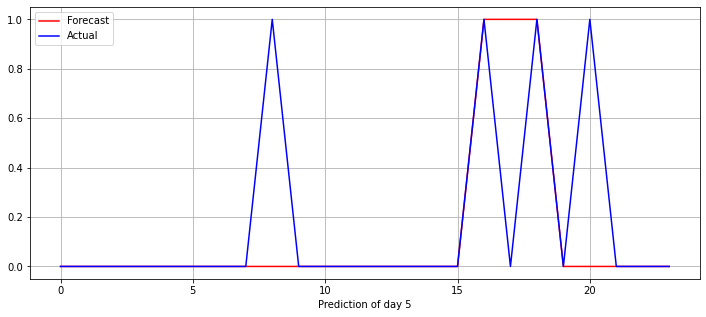

In [16]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 5, True)

## ESTACION MAS FRECUENTADA

In [67]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24(4000, 105, '31201', completeRentalsDf)

Shape del dataframe 'X_train' --> (4000, 24) // 'X_validation --> (105, 24) //  X_test --> (105, 24)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (105, 24) // Y_test --> (105, 24)


#### MODELO BASICO

In [21]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 1), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2496      
_________________________________________________________________
time_distributed_2 (TimeDist (None, 24, 1)             25        
Total params: 2,521
Trainable params: 2,521
Non-trainable params: 0
_________________________________________________________________
None


In [22]:
with tf.device('/GPU:0'):
    model.fit(X_train.reshape(X_train.shape[0], X_train.shape[1], 1), Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 984ms/step - loss: 36.9053 - mae: 4.0403
Epoch 2/10000
1/1 [==============================] - 0s 119ms/step - loss: 36.5263 - mae: 4.0127
Epoch 3/10000
1/1 [==============================] - 0s 112ms/step - loss: 36.1618 - mae: 3.9858
Epoch 4/10000
1/1 [==============================] - 0s 57ms/step - loss: 35.8113 - mae: 3.9597
Epoch 5/10000
1/1 [==============================] - 0s 9ms/step - loss: 35.4742 - mae: 3.9342
Epoch 6/10000
1/1 [==============================] - 0s 8ms/step - loss: 35.1496 - mae: 3.9095
Epoch 7/10000
1/1 [==============================] - 0s 8ms/step - loss: 34.8363 - mae: 3.8854
Epoch 8/10000
1/1 [==============================] - 0s 7ms/step - loss: 34.5333 - mae: 3.8618
Epoch 9/10000
1/1 [==============================] - 0s 7ms/step - loss: 34.2397 - mae: 3.8388
Epoch 10/10000
1/1 [==============================] - 0s 9ms/step - loss: 33.9546 - mae: 3.8162
Epoch 11/10000
1/1 [======================

In [23]:
score = model.evaluate(X_validation.reshape(X_validation.shape[0], X_validation.shape[1], 1), Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.8083675967276096
 Test loss: 7.886928558349609
 Test mae: 2.007401466369629


 Test rmse: 2.273388419653846
 Test loss: 5.168294906616211
 Test mae: 1.6478066444396973


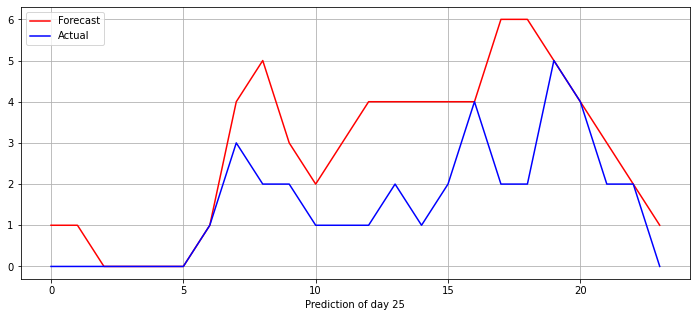

In [29]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test, Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 25, False)

#### MODELO MAS DENSO

In [30]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 1), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(X_train.shape[1], activation="relu", name="Dense_0")))
model.add(Dense(16, activation='relu', name='Dense_1'))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2496      
_________________________________________________________________
time_distributed_3 (TimeDist (None, 24, 24)            600       
_________________________________________________________________
Dense_1 (Dense)              (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)            

In [31]:
with tf.device('/GPU:0'):
    model.fit(X_train.reshape(X_train.shape[0], X_train.shape[1], 1), Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 39.1962 - mae: 4.2072
Epoch 2/10000
1/1 [==============================] - 0s 37ms/step - loss: 39.1911 - mae: 4.2070
Epoch 3/10000
1/1 [==============================] - 0s 47ms/step - loss: 39.1839 - mae: 4.2065
Epoch 4/10000
1/1 [==============================] - 0s 52ms/step - loss: 39.1735 - mae: 4.2058
Epoch 5/10000
1/1 [==============================] - 0s 49ms/step - loss: 39.1589 - mae: 4.2050
Epoch 6/10000
1/1 [==============================] - 0s 45ms/step - loss: 39.1477 - mae: 4.2043
Epoch 7/10000
1/1 [==============================] - 0s 10ms/step - loss: 39.1379 - mae: 4.2037
Epoch 8/10000
1/1 [==============================] - 0s 10ms/step - loss: 39.1260 - mae: 4.2029
Epoch 9/10000
1/1 [==============================] - 0s 10ms/step - loss: 39.1124 - mae: 4.2020
Epoch 10/10000
1/1 [==============================] - 0s 9ms/step - loss: 39.0973 - mae: 4.2009
Epoch 11/10000
1/1 [======================

In [32]:
score = model.evaluate(X_validation.reshape(X_validation.shape[0], X_validation.shape[1], 1), Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.7609612749389743
 Test loss: 7.6229071617126465
 Test mae: 1.9945898056030273


 Test rmse: 2.3070331598022698
 Test loss: 5.322402000427246
 Test mae: 1.6689419746398926


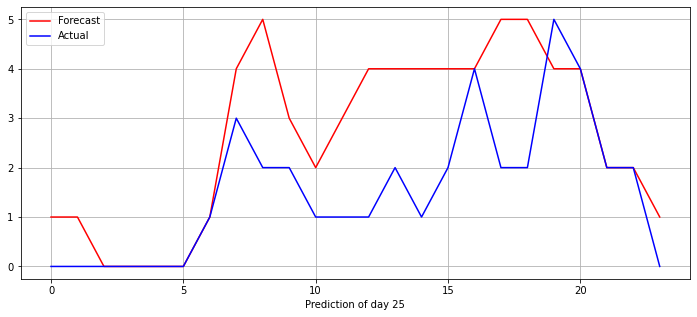

In [33]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test, Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 25, False)

#### MODELO MAS DENSO LOG1P

In [38]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 1), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2496      
_________________________________________________________________
time_distributed_4 (TimeDist (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,081
Trainable params: 3,081
Non-trainable params: 0
____________________________________________________

In [39]:
with tf.device('/GPU:0'):
    model.fit(X_train.reshape(X_train.shape[0], X_train.shape[1], 1), Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 1.8192 - mae: 1.0830
Epoch 2/10000
1/1 [==============================] - 0s 150ms/step - loss: 1.7062 - mae: 1.0503
Epoch 3/10000
1/1 [==============================] - 0s 74ms/step - loss: 1.6135 - mae: 1.0227
Epoch 4/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.5265 - mae: 0.9957
Epoch 5/10000
1/1 [==============================] - 0s 10ms/step - loss: 1.4466 - mae: 0.9698
Epoch 6/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.3753 - mae: 0.9459
Epoch 7/10000
1/1 [==============================] - 0s 12ms/step - loss: 1.3082 - mae: 0.9229
Epoch 8/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.2438 - mae: 0.9003
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.1818 - mae: 0.8783
Epoch 10/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.1225 - mae: 0.8569
Epoch 11/10000
1/1 [==============================] - 0

In [44]:
score = model.evaluate(X_validation.reshape(X_validation.shape[0], X_validation.shape[1], 1), Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation.reshape(X_validation.shape[0], X_validation.shape[1], 1), batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(X_validation, predictions)

 Test rmse: 0.568784679152048
 Test loss: 0.32351601123809814
 Test mae: 0.43941307067871094
MSE = 5.398915767669678, RMSE = 2.3235567063598164


MSE = 4.5594987869262695, RMSE = 2.135298289917891


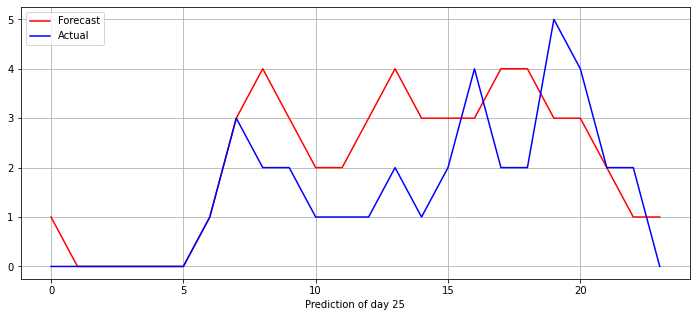

In [43]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 25, True)

### LSTM CON DISTRIBUTED LAYER [MANY TO MANY] t-24h & t-48h


In [122]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48(4000, 105, '31201', completeRentalsDf)

Shape del dataframe 'X_train' --> (4000, 24, 2) // 'X_validation --> (105, 24, 2) //  X_test --> (104, 24, 2)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (105, 24) // Y_test --> (104, 24)


#### MODELO SIMPLE

In [55]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 2), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2592      
_________________________________________________________________
time_distributed_6 (TimeDist (None, 24, 1)             25        
Total params: 2,617
Trainable params: 2,617
Non-trainable params: 0
_________________________________________________________________
None


In [56]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 864ms/step - loss: 37.6039 - mae: 4.0912
Epoch 2/10000
1/1 [==============================] - 0s 115ms/step - loss: 37.1895 - mae: 4.0611
Epoch 3/10000
1/1 [==============================] - 0s 126ms/step - loss: 36.7870 - mae: 4.0317
Epoch 4/10000
1/1 [==============================] - 0s 7ms/step - loss: 36.3954 - mae: 4.0030
Epoch 5/10000
1/1 [==============================] - 0s 7ms/step - loss: 36.0140 - mae: 3.9748
Epoch 6/10000
1/1 [==============================] - 0s 6ms/step - loss: 35.6418 - mae: 3.9472
Epoch 7/10000
1/1 [==============================] - 0s 11ms/step - loss: 35.2781 - mae: 3.9199
Epoch 8/10000
1/1 [==============================] - 0s 7ms/step - loss: 34.9223 - mae: 3.8930
Epoch 9/10000
1/1 [==============================] - 0s 7ms/step - loss: 34.5740 - mae: 3.8665
Epoch 10/10000
1/1 [==============================] - 0s 7ms/step - loss: 34.2329 - mae: 3.8402
Epoch 11/10000
1/1 [======================

In [58]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.757440558144755
 Test loss: 7.60347843170166
 Test mae: 1.955022931098938


 Test rmse: 2.232369756882876
 Test loss: 4.9834747314453125
 Test mae: 1.59254789352417


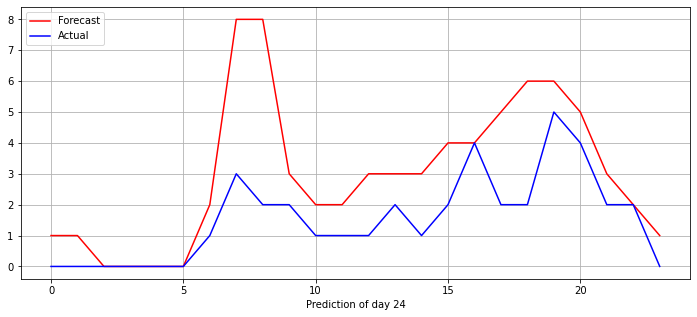

In [61]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test, Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 24, False)

#### MODELO MAS DENSO

In [127]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 2), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2592      
_________________________________________________________________
time_distributed_13 (TimeDis (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,177
Trainable params: 3,177
Non-trainable params: 0
___________________________________________________

In [128]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 980ms/step - loss: 39.1846 - mae: 4.2066
Epoch 2/10000
1/1 [==============================] - 0s 36ms/step - loss: 39.1345 - mae: 4.2031
Epoch 3/10000
1/1 [==============================] - 0s 45ms/step - loss: 39.0784 - mae: 4.1989
Epoch 4/10000
1/1 [==============================] - 0s 47ms/step - loss: 39.0069 - mae: 4.1936
Epoch 5/10000
1/1 [==============================] - 0s 50ms/step - loss: 38.9223 - mae: 4.1875
Epoch 6/10000
1/1 [==============================] - 0s 44ms/step - loss: 38.8268 - mae: 4.1806
Epoch 7/10000
1/1 [==============================] - 0s 34ms/step - loss: 38.7239 - mae: 4.1733
Epoch 8/10000
1/1 [==============================] - 0s 8ms/step - loss: 38.6180 - mae: 4.1660
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 38.5132 - mae: 4.1589
Epoch 10/10000
1/1 [==============================] - 0s 9ms/step - loss: 38.4100 - mae: 4.1520
Epoch 11/10000
1/1 [=====================

In [129]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.686596297091117
 Test loss: 7.217799663543701
 Test mae: 1.9346994161605835


 Test rmse: 2.2221042906409925
 Test loss: 4.937747478485107
 Test mae: 1.5953872203826904


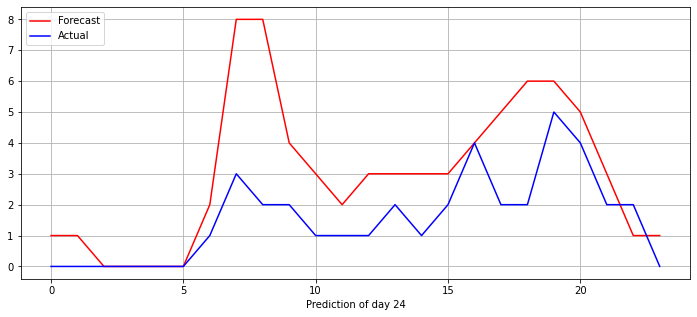

In [130]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test, Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 24, False)

#### MODELO SIMPLE LOG1P

In [71]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 2), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2592      
_________________________________________________________________
time_distributed_8 (TimeDist (None, 24, 1)             25        
Total params: 2,617
Trainable params: 2,617
Non-trainable params: 0
_________________________________________________________________
None


In [72]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 1.3853 - mae: 0.9455
Epoch 2/10000
1/1 [==============================] - 0s 80ms/step - loss: 1.3113 - mae: 0.9190
Epoch 3/10000
1/1 [==============================] - 0s 27ms/step - loss: 1.2412 - mae: 0.8933
Epoch 4/10000
1/1 [==============================] - 0s 31ms/step - loss: 1.1748 - mae: 0.8684
Epoch 5/10000
1/1 [==============================] - 0s 28ms/step - loss: 1.1119 - mae: 0.8443
Epoch 6/10000
1/1 [==============================] - 0s 25ms/step - loss: 1.0524 - mae: 0.8208
Epoch 7/10000
1/1 [==============================] - 0s 38ms/step - loss: 0.9961 - mae: 0.7980
Epoch 8/10000
1/1 [==============================] - 0s 28ms/step - loss: 0.9429 - mae: 0.7760
Epoch 9/10000
1/1 [==============================] - 0s 8ms/step - loss: 0.8928 - mae: 0.7546
Epoch 10/10000
1/1 [==============================] - 0s 6ms/step - loss: 0.8458 - mae: 0.7341
Epoch 11/10000
1/1 [==============================] -

In [109]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5561421086120579
 Test loss: 0.30929404497146606
 Test mae: 0.4257661998271942
MSE = 7.11393404006958, RMSE = 2.6671959133272494


MSE = 4.526828289031982, RMSE = 2.1276344350080403


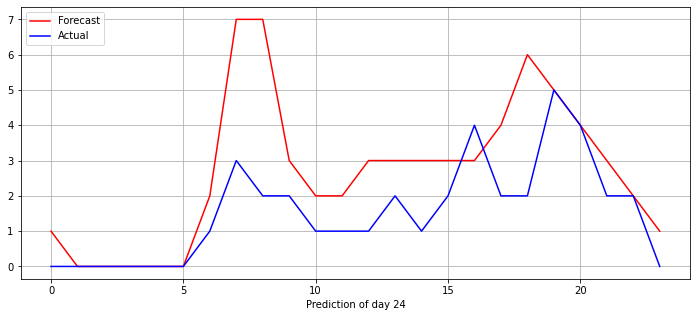

In [110]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 24, True)

### LSTM CON DISTRIBUTED LAYER [MANY TO MANY] t-24h, t-48h & t-168h

In [68]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168(4000, 102, '31201', completeRentalsDf)

Shape del dataframe 'X_train' --> (4000, 24, 3) // 'X_validation --> (102, 24, 3) //  X_test --> (102, 24, 3)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


#### MODELO SIMPLE

In [10]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 3), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2688      
_________________________________________________________________
time_distributed (TimeDistri (None, 24, 1)             25        
Total params: 2,713
Trainable params: 2,713
Non-trainable params: 0
_________________________________________________________________
None


In [11]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 4s 4s/step - loss: 37.1910 - mae: 4.0745
Epoch 2/10000
1/1 [==============================] - 0s 30ms/step - loss: 36.7734 - mae: 4.0439
Epoch 3/10000
1/1 [==============================] - 0s 38ms/step - loss: 36.3572 - mae: 4.0130
Epoch 4/10000
1/1 [==============================] - 0s 29ms/step - loss: 35.9436 - mae: 3.9821
Epoch 5/10000
1/1 [==============================] - 0s 49ms/step - loss: 35.5348 - mae: 3.9512
Epoch 6/10000
1/1 [==============================] - 0s 39ms/step - loss: 35.1327 - mae: 3.9207
Epoch 7/10000
1/1 [==============================] - 0s 7ms/step - loss: 34.7377 - mae: 3.8905
Epoch 8/10000
1/1 [==============================] - 0s 8ms/step - loss: 34.3504 - mae: 3.8607
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 33.9708 - mae: 3.8313
Epoch 10/10000
1/1 [==============================] - 0s 7ms/step - loss: 33.5990 - mae: 3.8023
Epoch 11/10000
1/1 [=========================

In [12]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.6240416094225636
 Test loss: 6.885594367980957
 Test mae: 1.8770562410354614


 Test rmse: 2.075728447141676
 Test loss: 4.308648586273193
 Test mae: 1.4743508100509644


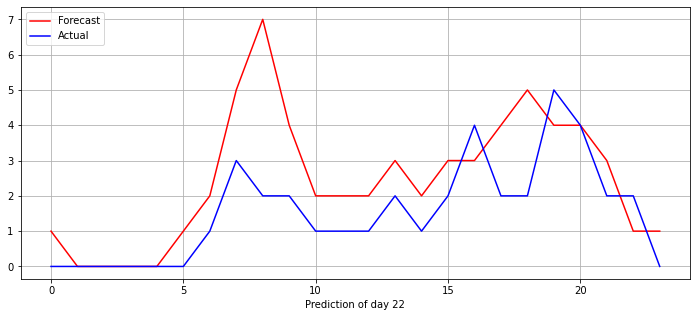

In [13]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test, Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 22, False)

#### MODELO MAS DENSO

In [14]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 3), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2688      
_________________________________________________________________
time_distributed_1 (TimeDist (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,273
Trainable params: 3,273
Non-trainable params: 0
____________________________________________________

In [15]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 38.1847 - mae: 4.1322
Epoch 2/10000
1/1 [==============================] - 0s 71ms/step - loss: 37.9596 - mae: 4.1152
Epoch 3/10000
1/1 [==============================] - 0s 62ms/step - loss: 37.7253 - mae: 4.0974
Epoch 4/10000
1/1 [==============================] - 0s 29ms/step - loss: 37.4817 - mae: 4.0791
Epoch 5/10000
1/1 [==============================] - 0s 29ms/step - loss: 37.2301 - mae: 4.0600
Epoch 6/10000
1/1 [==============================] - 0s 30ms/step - loss: 36.9706 - mae: 4.0404
Epoch 7/10000
1/1 [==============================] - 0s 36ms/step - loss: 36.7043 - mae: 4.0203
Epoch 8/10000
1/1 [==============================] - 0s 27ms/step - loss: 36.4312 - mae: 3.9995
Epoch 9/10000
1/1 [==============================] - 0s 11ms/step - loss: 36.1526 - mae: 3.9783
Epoch 10/10000
1/1 [==============================] - 0s 11ms/step - loss: 35.8683 - mae: 3.9567
Epoch 11/10000
1/1 [=====================

In [16]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.614087720203214
 Test loss: 6.833454608917236
 Test mae: 1.8470432758331299


 Test rmse: 2.055435914633151
 Test loss: 4.224816799163818
 Test mae: 1.4725381135940552


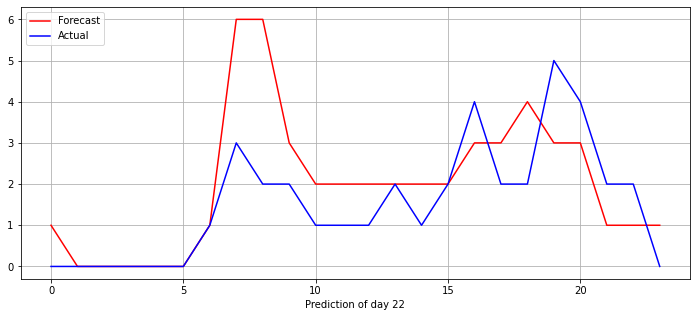

In [23]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test, Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 22, False)

#### MODELO LOG1P

In [69]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 3), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2688      
_________________________________________________________________
time_distributed_8 (TimeDist (None, 24, 1)             25        
Total params: 2,713
Trainable params: 2,713
Non-trainable params: 0
_________________________________________________________________
None


In [70]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 878ms/step - loss: 1.9770 - mae: 1.1304
Epoch 2/10000
1/1 [==============================] - 0s 75ms/step - loss: 1.8776 - mae: 1.1027
Epoch 3/10000
1/1 [==============================] - 0s 30ms/step - loss: 1.7823 - mae: 1.0753
Epoch 4/10000
1/1 [==============================] - 0s 25ms/step - loss: 1.6908 - mae: 1.0481
Epoch 5/10000
1/1 [==============================] - 0s 35ms/step - loss: 1.6031 - mae: 1.0210
Epoch 6/10000
1/1 [==============================] - 0s 39ms/step - loss: 1.5190 - mae: 0.9940
Epoch 7/10000
1/1 [==============================] - 0s 40ms/step - loss: 1.4384 - mae: 0.9671
Epoch 8/10000
1/1 [==============================] - 0s 11ms/step - loss: 1.3612 - mae: 0.9403
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.2874 - mae: 0.9136
Epoch 10/10000
1/1 [==============================] - 0s 12ms/step - loss: 1.2170 - mae: 0.8876
Epoch 11/10000
1/1 [=============================

In [71]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5181088012261416
 Test loss: 0.2684367299079895
 Test mae: 0.39809489250183105
MSE = 6.47796630859375, RMSE = 2.545184926207475


MSE = 4.08251428604126, RMSE = 2.020523270353811


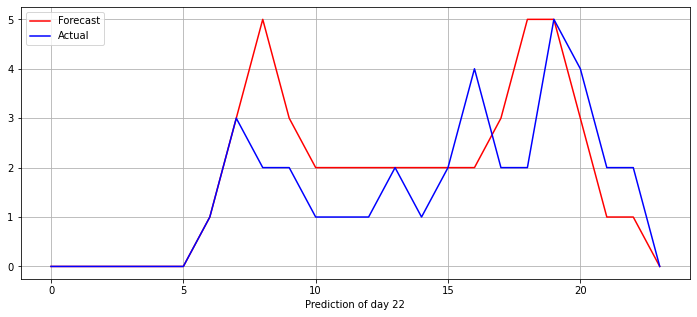

In [72]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

#### MODELO LOG1P MAS DENSO

In [77]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 3), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2688      
_________________________________________________________________
time_distributed_11 (TimeDis (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,273
Trainable params: 3,273
Non-trainable params: 0
___________________________________________________

In [78]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 2.4247 - mae: 1.2473
Epoch 2/10000
1/1 [==============================] - 0s 49ms/step - loss: 2.4222 - mae: 1.2469
Epoch 3/10000
1/1 [==============================] - 0s 63ms/step - loss: 2.4208 - mae: 1.2467
Epoch 4/10000
1/1 [==============================] - 0s 47ms/step - loss: 2.4190 - mae: 1.2465
Epoch 5/10000
1/1 [==============================] - 0s 51ms/step - loss: 2.4169 - mae: 1.2461
Epoch 6/10000
1/1 [==============================] - 0s 49ms/step - loss: 2.4146 - mae: 1.2458
Epoch 7/10000
1/1 [==============================] - 0s 49ms/step - loss: 2.4119 - mae: 1.2454
Epoch 8/10000
1/1 [==============================] - 0s 11ms/step - loss: 2.4089 - mae: 1.2448
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 2.4053 - mae: 1.2442
Epoch 10/10000
1/1 [==============================] - 0s 9ms/step - loss: 2.4007 - mae: 1.2432
Epoch 11/10000
1/1 [==============================] -

In [79]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5259976195473709
 Test loss: 0.27667349576950073
 Test mae: 0.40057945251464844
MSE = 6.624712944030762, RMSE = 2.5738517719617735


MSE = 4.24177360534668, RMSE = 2.0595566526188787


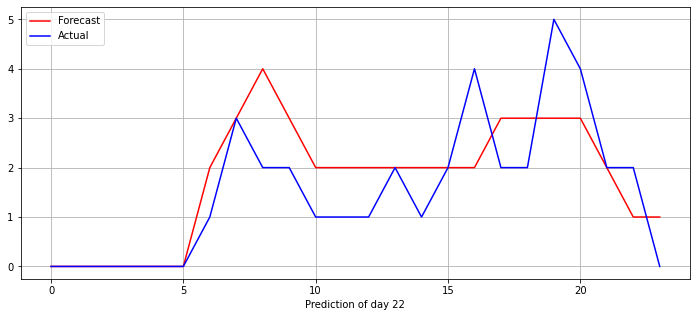

In [80]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

### LSTM CON DISTRIBUTED LAYER [MANY TO MANY] t-24h, t-48h & t-168h + Exogenous Variables (Temp. + Humidity)

In [81]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168_ExogVariables(4000, 102, '31201', completeRentalsDf, completeWeatherDf)

Shape del dataframe 'X_train' --> (4000, 24, 5) // 'X_validation --> (102, 24, 5) //  X_test --> (102, 24, 5)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


#### MODELO SIMPLE

In [35]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_4 (TimeDist (None, 24, 1)             25        
Total params: 2,905
Trainable params: 2,905
Non-trainable params: 0
_________________________________________________________________
None


In [36]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 701ms/step - loss: 36.4021 - mae: 4.0464
Epoch 2/10000
1/1 [==============================] - 0s 57ms/step - loss: 36.1906 - mae: 4.0330
Epoch 3/10000
1/1 [==============================] - 0s 54ms/step - loss: 35.9865 - mae: 4.0199
Epoch 4/10000
1/1 [==============================] - 0s 9ms/step - loss: 35.7887 - mae: 4.0071
Epoch 5/10000
1/1 [==============================] - 0s 9ms/step - loss: 35.5968 - mae: 3.9947
Epoch 6/10000
1/1 [==============================] - 0s 10ms/step - loss: 35.4098 - mae: 3.9825
Epoch 7/10000
1/1 [==============================] - 0s 10ms/step - loss: 35.2270 - mae: 3.9706
Epoch 8/10000
1/1 [==============================] - 0s 10ms/step - loss: 35.0483 - mae: 3.9588
Epoch 9/10000
1/1 [==============================] - 0s 13ms/step - loss: 34.8731 - mae: 3.9473
Epoch 10/10000
1/1 [==============================] - 0s 9ms/step - loss: 34.7008 - mae: 3.9359
Epoch 11/10000
1/1 [=====================

In [37]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.5988462088841735
 Test loss: 6.754001617431641
 Test mae: 1.8545955419540405


 Test rmse: 2.0319785352158926
 Test loss: 4.128936767578125
 Test mae: 1.4219870567321777


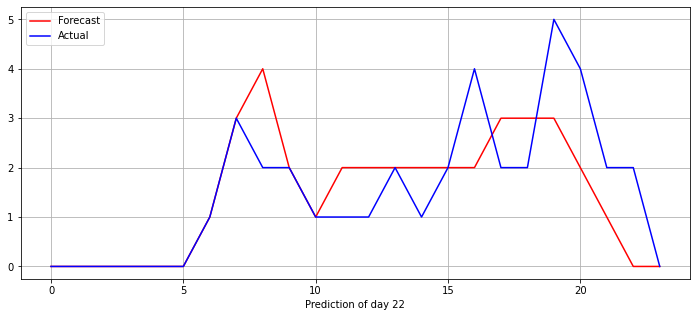

In [39]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test, Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 22, False)

#### MODELO MAS DENSO

In [40]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_5 (TimeDist (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,465
Trainable params: 3,465
Non-trainable params: 0
____________________________________________________

In [41]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 819ms/step - loss: 39.2319 - mae: 4.2114
Epoch 2/10000
1/1 [==============================] - 0s 72ms/step - loss: 39.2234 - mae: 4.2109
Epoch 3/10000
1/1 [==============================] - 0s 76ms/step - loss: 39.2187 - mae: 4.2106
Epoch 4/10000
1/1 [==============================] - 0s 10ms/step - loss: 39.2123 - mae: 4.2102
Epoch 5/10000
1/1 [==============================] - 0s 8ms/step - loss: 39.2048 - mae: 4.2098
Epoch 6/10000
1/1 [==============================] - 0s 11ms/step - loss: 39.1965 - mae: 4.2093
Epoch 7/10000
1/1 [==============================] - 0s 10ms/step - loss: 39.1873 - mae: 4.2087
Epoch 8/10000
1/1 [==============================] - 0s 12ms/step - loss: 39.1771 - mae: 4.2081
Epoch 9/10000
1/1 [==============================] - 0s 10ms/step - loss: 39.1657 - mae: 4.2074
Epoch 10/10000
1/1 [==============================] - 0s 10ms/step - loss: 39.1530 - mae: 4.2066
Epoch 11/10000
1/1 [===================

In [44]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.5566746627138803
 Test loss: 6.536585330963135
 Test mae: 1.8375662565231323


 Test rmse: 2.00202898579592
 Test loss: 4.008120059967041
 Test mae: 1.4201217889785767


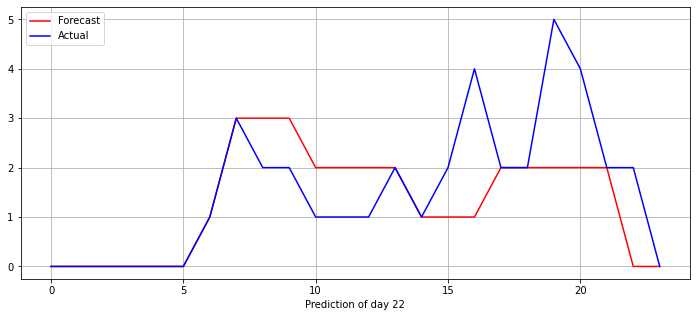

In [45]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test, Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 22, False)

#### MODELO SIMPLE LOG1P

In [82]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_12 (TimeDis (None, 24, 1)             25        
Total params: 2,905
Trainable params: 2,905
Non-trainable params: 0
_________________________________________________________________
None


In [83]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 671ms/step - loss: 1.4746 - mae: 1.0270
Epoch 2/10000
1/1 [==============================] - 0s 24ms/step - loss: 1.4143 - mae: 1.0082
Epoch 3/10000
1/1 [==============================] - 0s 24ms/step - loss: 1.3573 - mae: 0.9900
Epoch 4/10000
1/1 [==============================] - 0s 25ms/step - loss: 1.3037 - mae: 0.9725
Epoch 5/10000
1/1 [==============================] - 0s 24ms/step - loss: 1.2536 - mae: 0.9558
Epoch 6/10000
1/1 [==============================] - 0s 24ms/step - loss: 1.2068 - mae: 0.9400
Epoch 7/10000
1/1 [==============================] - 0s 23ms/step - loss: 1.1631 - mae: 0.9249
Epoch 8/10000
1/1 [==============================] - 0s 24ms/step - loss: 1.1226 - mae: 0.9105
Epoch 9/10000
1/1 [==============================] - 0s 24ms/step - loss: 1.0848 - mae: 0.8967
Epoch 10/10000
1/1 [==============================] - 0s 24ms/step - loss: 1.0497 - mae: 0.8835
Epoch 11/10000
1/1 [============================

In [85]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5190545383143622
 Test loss: 0.2694176137447357
 Test mae: 0.3903522491455078
MSE = 6.337766647338867, RMSE = 2.5174921345138035


MSE = 3.8060944080352783, RMSE = 1.9509214253873164


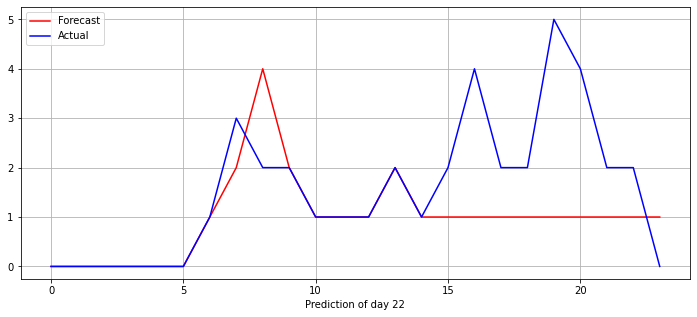

In [86]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

#### MODELO DENSO LOG1P

In [95]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_16 (TimeDis (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,465
Trainable params: 3,465
Non-trainable params: 0
___________________________________________________

In [96]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 2.3910 - mae: 1.2410
Epoch 2/10000
1/1 [==============================] - 0s 93ms/step - loss: 2.3745 - mae: 1.2377
Epoch 3/10000
1/1 [==============================] - 0s 9ms/step - loss: 2.3578 - mae: 1.2343
Epoch 4/10000
1/1 [==============================] - 0s 9ms/step - loss: 2.3404 - mae: 1.2308
Epoch 5/10000
1/1 [==============================] - 0s 8ms/step - loss: 2.3224 - mae: 1.2271
Epoch 6/10000
1/1 [==============================] - 0s 10ms/step - loss: 2.3040 - mae: 1.2233
Epoch 7/10000
1/1 [==============================] - 0s 11ms/step - loss: 2.2851 - mae: 1.2194
Epoch 8/10000
1/1 [==============================] - 0s 9ms/step - loss: 2.2658 - mae: 1.2154
Epoch 9/10000
1/1 [==============================] - 0s 12ms/step - loss: 2.2466 - mae: 1.2114
Epoch 10/10000
1/1 [==============================] - 0s 10ms/step - loss: 2.2279 - mae: 1.2075
Epoch 11/10000
1/1 [==============================] - 0

In [97]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5180183122262743
 Test loss: 0.2683429718017578
 Test mae: 0.39141708612442017
MSE = 6.221428394317627, RMSE = 2.494279133200137


MSE = 3.5897674560546875, RMSE = 1.8946681651557582


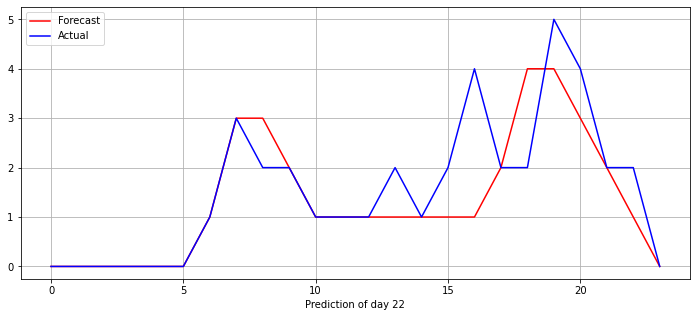

In [98]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

### LSTM CON DISTRIBUTED LAYER [MANY TO MANY] t-24h, t-48h, t-144h, t-168h

In [99]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T144T168(4000, 102, '31201', completeRentalsDf)

Shape del dataframe 'X_train' --> (4000, 24, 4) // 'X_validation --> (102, 24, 4) //  X_test --> (102, 24, 4)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


#### MODELO SIMPLE

In [47]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 4), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2784      
_________________________________________________________________
time_distributed_6 (TimeDist (None, 24, 1)             25        
Total params: 2,809
Trainable params: 2,809
Non-trainable params: 0
_________________________________________________________________
None


In [48]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 38.9708 - mae: 4.1964
Epoch 2/10000
1/1 [==============================] - 0s 66ms/step - loss: 38.8550 - mae: 4.1887
Epoch 3/10000
1/1 [==============================] - 0s 94ms/step - loss: 38.7271 - mae: 4.1798
Epoch 4/10000
1/1 [==============================] - 0s 8ms/step - loss: 38.5862 - mae: 4.1698
Epoch 5/10000
1/1 [==============================] - 0s 8ms/step - loss: 38.4314 - mae: 4.1586
Epoch 6/10000
1/1 [==============================] - 0s 7ms/step - loss: 38.2630 - mae: 4.1464
Epoch 7/10000
1/1 [==============================] - 0s 8ms/step - loss: 38.0811 - mae: 4.1330
Epoch 8/10000
1/1 [==============================] - 0s 7ms/step - loss: 37.8846 - mae: 4.1184
Epoch 9/10000
1/1 [==============================] - 0s 7ms/step - loss: 37.6743 - mae: 4.1027
Epoch 10/10000
1/1 [==============================] - 0s 6ms/step - loss: 37.4500 - mae: 4.0858
Epoch 11/10000
1/1 [============================

In [50]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.5698056170504078
 Test loss: 6.603900909423828
 Test mae: 1.820717453956604


 Test rmse: 2.024084392816155
 Test loss: 4.096917629241943
 Test mae: 1.4403209686279297


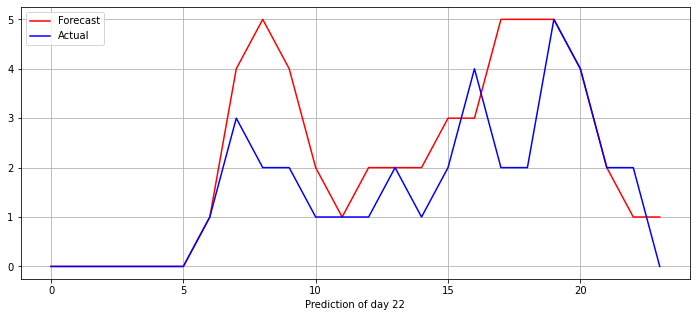

In [51]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test, Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 22, False)

#### MODELO MAS DENSO

In [52]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 4), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2784      
_________________________________________________________________
time_distributed_7 (TimeDist (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,369
Trainable params: 3,369
Non-trainable params: 0
____________________________________________________

In [53]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 870ms/step - loss: 39.2098 - mae: 4.2098
Epoch 2/10000
1/1 [==============================] - 0s 34ms/step - loss: 39.1798 - mae: 4.2078
Epoch 3/10000
1/1 [==============================] - 0s 34ms/step - loss: 39.1514 - mae: 4.2059
Epoch 4/10000
1/1 [==============================] - 0s 32ms/step - loss: 39.1236 - mae: 4.2039
Epoch 5/10000
1/1 [==============================] - 0s 37ms/step - loss: 39.0976 - mae: 4.2021
Epoch 6/10000
1/1 [==============================] - 0s 35ms/step - loss: 39.0732 - mae: 4.2005
Epoch 7/10000
1/1 [==============================] - 0s 11ms/step - loss: 39.0494 - mae: 4.1989
Epoch 8/10000
1/1 [==============================] - 0s 12ms/step - loss: 39.0254 - mae: 4.1973
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 39.0009 - mae: 4.1958
Epoch 10/10000
1/1 [==============================] - 0s 12ms/step - loss: 38.9758 - mae: 4.1942
Epoch 11/10000
1/1 [===================

In [56]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))

 Test rmse: 2.673304838883265
 Test loss: 7.14655876159668
 Test mae: 1.9014317989349365


 Test rmse: 2.0794071458510843
 Test loss: 4.323934078216553
 Test mae: 1.483971118927002


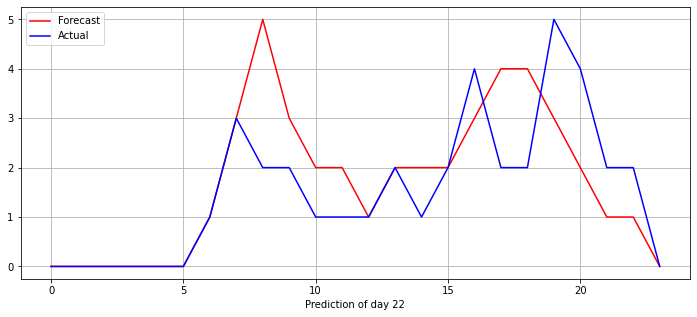

In [57]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
score = model.evaluate(X_test, Y_test.reshape(Y_test.shape[0], Y_test.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
plotDayPrediction(predictions, Y_test, 22, False)

#### MODELO SIMPLE LOG1P

In [100]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 4), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2784      
_________________________________________________________________
time_distributed_17 (TimeDis (None, 24, 1)             25        
Total params: 2,809
Trainable params: 2,809
Non-trainable params: 0
_________________________________________________________________
None


In [101]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 893ms/step - loss: 1.6377 - mae: 1.0303
Epoch 2/10000
1/1 [==============================] - 0s 88ms/step - loss: 1.5233 - mae: 0.9940
Epoch 3/10000
1/1 [==============================] - 0s 118ms/step - loss: 1.4155 - mae: 0.9580
Epoch 4/10000
1/1 [==============================] - 0s 8ms/step - loss: 1.3142 - mae: 0.9223
Epoch 5/10000
1/1 [==============================] - 0s 7ms/step - loss: 1.2191 - mae: 0.8873
Epoch 6/10000
1/1 [==============================] - 0s 8ms/step - loss: 1.1302 - mae: 0.8533
Epoch 7/10000
1/1 [==============================] - 0s 7ms/step - loss: 1.0474 - mae: 0.8209
Epoch 8/10000
1/1 [==============================] - 0s 7ms/step - loss: 0.9705 - mae: 0.7901
Epoch 9/10000
1/1 [==============================] - 0s 8ms/step - loss: 0.8995 - mae: 0.7607
Epoch 10/10000
1/1 [==============================] - 0s 7ms/step - loss: 0.8343 - mae: 0.7325
Epoch 11/10000
1/1 [==============================] - 

In [102]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5256095345089581
 Test loss: 0.27626538276672363
 Test mae: 0.3999185562133789
MSE = 6.632826328277588, RMSE = 2.5754274069128


MSE = 4.137880802154541, RMSE = 2.03417816381814


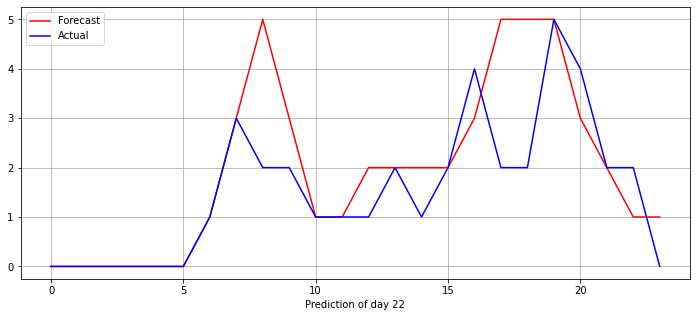

In [103]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

#### MODELO MAS DENSO LOG1P

In [104]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 4), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2784      
_________________________________________________________________
time_distributed_18 (TimeDis (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,369
Trainable params: 3,369
Non-trainable params: 0
___________________________________________________

In [105]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 851ms/step - loss: 2.0373 - mae: 1.1517
Epoch 2/10000
1/1 [==============================] - 0s 203ms/step - loss: 1.9072 - mae: 1.1174
Epoch 3/10000
1/1 [==============================] - 0s 10ms/step - loss: 1.7789 - mae: 1.0819
Epoch 4/10000
1/1 [==============================] - 0s 12ms/step - loss: 1.6525 - mae: 1.0449
Epoch 5/10000
1/1 [==============================] - 0s 11ms/step - loss: 1.5283 - mae: 1.0065
Epoch 6/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.4067 - mae: 0.9665
Epoch 7/10000
1/1 [==============================] - 0s 12ms/step - loss: 1.2877 - mae: 0.9248
Epoch 8/10000
1/1 [==============================] - 0s 12ms/step - loss: 1.1712 - mae: 0.8819
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.0575 - mae: 0.8387
Epoch 10/10000
1/1 [==============================] - 0s 12ms/step - loss: 0.9479 - mae: 0.7954
Epoch 11/10000
1/1 [=============================

In [106]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5195078736976144
 Test loss: 0.26988843083381653
 Test mae: 0.3987589180469513
MSE = 6.389026165008545, RMSE = 2.527652303029146


MSE = 4.098750591278076, RMSE = 2.0245371301307555


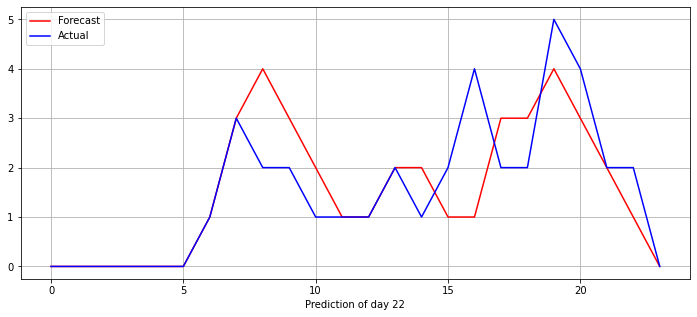

In [107]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

## PRUEBAS CON OTRAS ESTACIONES

### LSTM CON DISTRIBUTED LAYER [MANY TO MANY] t-24h, t-48h & t-168h + Exogenous Variables (Temp. + Humidity)

### MODELO SIMPLE LOG1P

#### Estación 31200

In [116]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168_ExogVariables(4000, 102, '31200', completeRentalsDf, completeWeatherDf)

Shape del dataframe 'X_train' --> (4000, 24, 5) // 'X_validation --> (102, 24, 5) //  X_test --> (102, 24, 5)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


In [117]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_19 (TimeDis (None, 24, 1)             25        
Total params: 2,905
Trainable params: 2,905
Non-trainable params: 0
_________________________________________________________________
None


In [118]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1000ms/step - loss: 2.0547 - mae: 1.1677
Epoch 2/10000
1/1 [==============================] - 0s 95ms/step - loss: 2.0197 - mae: 1.1591
Epoch 3/10000
1/1 [==============================] - 0s 78ms/step - loss: 1.9853 - mae: 1.1505
Epoch 4/10000
1/1 [==============================] - 0s 6ms/step - loss: 1.9513 - mae: 1.1419
Epoch 5/10000
1/1 [==============================] - 0s 6ms/step - loss: 1.9176 - mae: 1.1332
Epoch 6/10000
1/1 [==============================] - 0s 7ms/step - loss: 1.8844 - mae: 1.1246
Epoch 7/10000
1/1 [==============================] - 0s 8ms/step - loss: 1.8517 - mae: 1.1159
Epoch 8/10000
1/1 [==============================] - 0s 7ms/step - loss: 1.8193 - mae: 1.1072
Epoch 9/10000
1/1 [==============================] - 0s 7ms/step - loss: 1.7873 - mae: 1.0985
Epoch 10/10000
1/1 [==============================] - 0s 7ms/step - loss: 1.7556 - mae: 1.0898
Epoch 11/10000
1/1 [==============================] - 

In [119]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5518119852934465
 Test loss: 0.3044964671134949
 Test mae: 0.4168042540550232
MSE = 6.720174789428711, RMSE = 2.592329992386909


MSE = 3.10849928855896, RMSE = 1.763093669819888


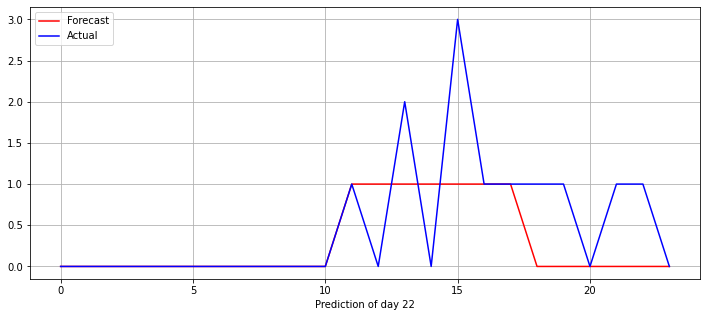

In [121]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

#### Estación 31101

In [122]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168_ExogVariables(4000, 102, '31101', completeRentalsDf, completeWeatherDf)

Shape del dataframe 'X_train' --> (4000, 24, 5) // 'X_validation --> (102, 24, 5) //  X_test --> (102, 24, 5)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


In [123]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_20 (TimeDis (None, 24, 1)             25        
Total params: 2,905
Trainable params: 2,905
Non-trainable params: 0
_________________________________________________________________
None


In [124]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 837ms/step - loss: 1.9455 - mae: 1.1111
Epoch 2/10000
1/1 [==============================] - 0s 59ms/step - loss: 1.9452 - mae: 1.1110
Epoch 3/10000
1/1 [==============================] - 0s 43ms/step - loss: 1.9447 - mae: 1.1108
Epoch 4/10000
1/1 [==============================] - 0s 32ms/step - loss: 1.9441 - mae: 1.1107
Epoch 5/10000
1/1 [==============================] - 0s 30ms/step - loss: 1.9432 - mae: 1.1104
Epoch 6/10000
1/1 [==============================] - 0s 32ms/step - loss: 1.9422 - mae: 1.1101
Epoch 7/10000
1/1 [==============================] - 0s 24ms/step - loss: 1.9408 - mae: 1.1097
Epoch 8/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.9391 - mae: 1.1093
Epoch 9/10000
1/1 [==============================] - 0s 7ms/step - loss: 1.9371 - mae: 1.1087
Epoch 10/10000
1/1 [==============================] - 0s 7ms/step - loss: 1.9347 - mae: 1.1080
Epoch 11/10000
1/1 [==============================]

In [125]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.561183209385111
 Test loss: 0.3149265944957733
 Test mae: 0.4314698874950409
MSE = 5.546624183654785, RMSE = 2.355127211777484


MSE = 3.3631582260131836, RMSE = 1.8338915524133872


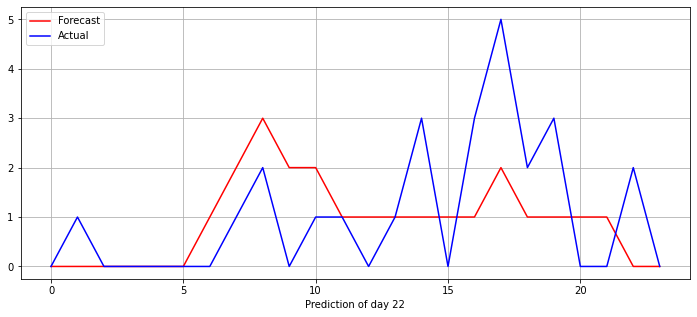

In [126]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

#### Estación 31230

In [127]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168_ExogVariables(4000, 102, '31230', completeRentalsDf, completeWeatherDf)

Shape del dataframe 'X_train' --> (4000, 24, 5) // 'X_validation --> (102, 24, 5) //  X_test --> (102, 24, 5)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


In [128]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_21 (TimeDis (None, 24, 1)             25        
Total params: 2,905
Trainable params: 2,905
Non-trainable params: 0
_________________________________________________________________
None


In [129]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 909ms/step - loss: 0.9536 - mae: 0.6704
Epoch 2/10000
1/1 [==============================] - 0s 7ms/step - loss: 0.9240 - mae: 0.6662
Epoch 3/10000
1/1 [==============================] - 0s 7ms/step - loss: 0.8961 - mae: 0.6624
Epoch 4/10000
1/1 [==============================] - 0s 6ms/step - loss: 0.8697 - mae: 0.6587
Epoch 5/10000
1/1 [==============================] - 0s 7ms/step - loss: 0.8447 - mae: 0.6553
Epoch 6/10000
1/1 [==============================] - 0s 7ms/step - loss: 0.8212 - mae: 0.6522
Epoch 7/10000
1/1 [==============================] - 0s 9ms/step - loss: 0.7992 - mae: 0.6493
Epoch 8/10000
1/1 [==============================] - 0s 7ms/step - loss: 0.7786 - mae: 0.6467
Epoch 9/10000
1/1 [==============================] - 0s 8ms/step - loss: 0.7594 - mae: 0.6443
Epoch 10/10000
1/1 [==============================] - 0s 6ms/step - loss: 0.7415 - mae: 0.6422
Epoch 11/10000
1/1 [==============================] - 0s 

In [130]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5178844193382974
 Test loss: 0.2682042717933655
 Test mae: 0.3741951584815979
MSE = 3.1072700023651123, RMSE = 1.7627450191009226


MSE = 1.619612455368042, RMSE = 1.272639955120081


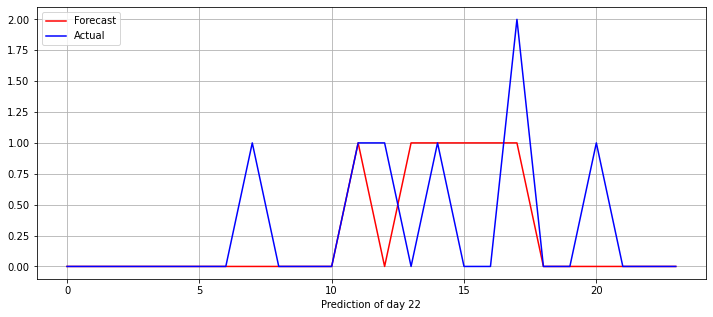

In [131]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

#### Estación 31611

In [132]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168_ExogVariables(4000, 102, '31611', completeRentalsDf, completeWeatherDf)

Shape del dataframe 'X_train' --> (4000, 24, 5) // 'X_validation --> (102, 24, 5) //  X_test --> (102, 24, 5)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


In [133]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(1, activation="relu", name="Dense_1")))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_22"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_22 (TimeDis (None, 24, 1)             25        
Total params: 2,905
Trainable params: 2,905
Non-trainable params: 0
_________________________________________________________________
None


In [134]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 722ms/step - loss: 0.4103 - mae: 0.5310
Epoch 2/10000
1/1 [==============================] - 0s 58ms/step - loss: 0.4083 - mae: 0.5292
Epoch 3/10000
1/1 [==============================] - 0s 56ms/step - loss: 0.4068 - mae: 0.5282
Epoch 4/10000
1/1 [==============================] - 0s 57ms/step - loss: 0.4056 - mae: 0.5276
Epoch 5/10000
1/1 [==============================] - 0s 60ms/step - loss: 0.4046 - mae: 0.5275
Epoch 6/10000
1/1 [==============================] - 0s 10ms/step - loss: 0.4037 - mae: 0.5276
Epoch 7/10000
1/1 [==============================] - 0s 7ms/step - loss: 0.4030 - mae: 0.5278
Epoch 8/10000
1/1 [==============================] - 0s 7ms/step - loss: 0.4024 - mae: 0.5280
Epoch 9/10000
1/1 [==============================] - 0s 8ms/step - loss: 0.4018 - mae: 0.5283
Epoch 10/10000
1/1 [==============================] - 0s 10ms/step - loss: 0.4014 - mae: 0.5284
Epoch 11/10000
1/1 [==============================]

In [135]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5054232510543764
 Test loss: 0.2554526627063751
 Test mae: 0.38712868094444275
MSE = 2.1862876415252686, RMSE = 1.4786100370027482


MSE = 1.162889003753662, RMSE = 1.0783733137247333


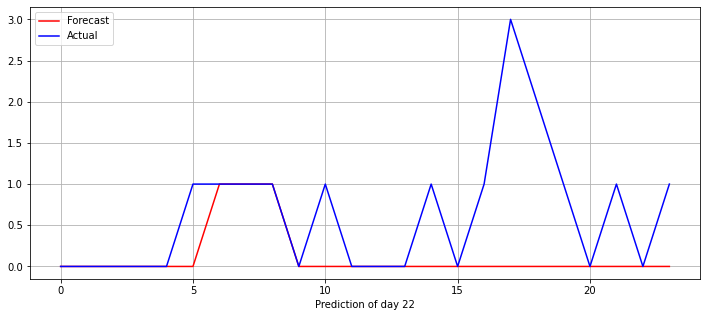

In [136]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

### MODELO MAS DENSO LOG1P

#### Estación 31200

In [140]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168_ExogVariables(4000, 102, '31200', completeRentalsDf, completeWeatherDf)

Shape del dataframe 'X_train' --> (4000, 24, 5) // 'X_validation --> (102, 24, 5) //  X_test --> (102, 24, 5)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


In [143]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_25"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_25 (TimeDis (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,465
Trainable params: 3,465
Non-trainable params: 0
___________________________________________________

In [144]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 2.6579 - mae: 1.2911
Epoch 2/10000
1/1 [==============================] - 0s 123ms/step - loss: 2.6357 - mae: 1.2871
Epoch 3/10000
1/1 [==============================] - 0s 112ms/step - loss: 2.6135 - mae: 1.2829
Epoch 4/10000
1/1 [==============================] - 0s 9ms/step - loss: 2.5916 - mae: 1.2788
Epoch 5/10000
1/1 [==============================] - 0s 8ms/step - loss: 2.5697 - mae: 1.2746
Epoch 6/10000
1/1 [==============================] - 0s 8ms/step - loss: 2.5479 - mae: 1.2704
Epoch 7/10000
1/1 [==============================] - 0s 9ms/step - loss: 2.5261 - mae: 1.2661
Epoch 8/10000
1/1 [==============================] - 0s 9ms/step - loss: 2.5041 - mae: 1.2618
Epoch 9/10000
1/1 [==============================] - 0s 10ms/step - loss: 2.4821 - mae: 1.2575
Epoch 10/10000
1/1 [==============================] - 0s 13ms/step - loss: 2.4598 - mae: 1.2530
Epoch 11/10000
1/1 [==============================] - 

In [145]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5532527420468991
 Test loss: 0.3060885965824127
 Test mae: 0.419230192899704
MSE = 6.602537631988525, RMSE = 2.569540354224569


MSE = 2.9941883087158203, RMSE = 1.7303723034988223


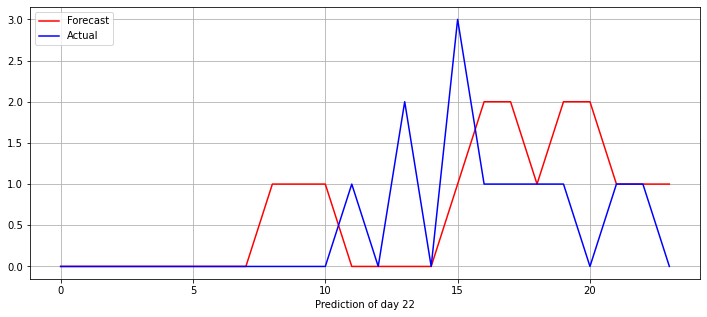

In [146]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

#### Estación 31101

In [162]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168_ExogVariables(4000, 102, '31101', completeRentalsDf, completeWeatherDf)

Shape del dataframe 'X_train' --> (4000, 24, 5) // 'X_validation --> (102, 24, 5) //  X_test --> (102, 24, 5)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


In [163]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_30"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_30 (TimeDis (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,465
Trainable params: 3,465
Non-trainable params: 0
___________________________________________________

In [164]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 858ms/step - loss: 1.3920 - mae: 0.9768
Epoch 2/10000
1/1 [==============================] - 0s 190ms/step - loss: 1.3562 - mae: 0.9656
Epoch 3/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.3206 - mae: 0.9542
Epoch 4/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.2853 - mae: 0.9426
Epoch 5/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.2502 - mae: 0.9307
Epoch 6/10000
1/1 [==============================] - 0s 10ms/step - loss: 1.2153 - mae: 0.9185
Epoch 7/10000
1/1 [==============================] - 0s 10ms/step - loss: 1.1809 - mae: 0.9061
Epoch 8/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.1470 - mae: 0.8935
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.1138 - mae: 0.8806
Epoch 10/10000
1/1 [==============================] - 0s 12ms/step - loss: 1.0816 - mae: 0.8676
Epoch 11/10000
1/1 [==============================] 

In [165]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5577808413884747
 Test loss: 0.3111194670200348
 Test mae: 0.43062371015548706
MSE = 5.604820728302002, RMSE = 2.367450258886552


MSE = 3.3949878215789795, RMSE = 1.8425492724969337


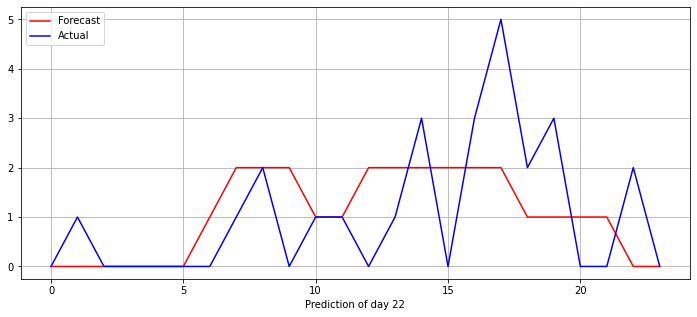

In [166]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

#### Estación 31230

In [167]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168_ExogVariables(4000, 102, '31230', completeRentalsDf, completeWeatherDf)

Shape del dataframe 'X_train' --> (4000, 24, 5) // 'X_validation --> (102, 24, 5) //  X_test --> (102, 24, 5)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


In [168]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_31"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_31 (TimeDis (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,465
Trainable params: 3,465
Non-trainable params: 0
___________________________________________________

In [169]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 1.1963 - mae: 0.7200
Epoch 2/10000
1/1 [==============================] - 0s 73ms/step - loss: 1.1910 - mae: 0.7196
Epoch 3/10000
1/1 [==============================] - 0s 72ms/step - loss: 1.1859 - mae: 0.7192
Epoch 4/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.1807 - mae: 0.7189
Epoch 5/10000
1/1 [==============================] - 0s 10ms/step - loss: 1.1754 - mae: 0.7186
Epoch 6/10000
1/1 [==============================] - 0s 11ms/step - loss: 1.1700 - mae: 0.7183
Epoch 7/10000
1/1 [==============================] - 0s 11ms/step - loss: 1.1645 - mae: 0.7180
Epoch 8/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.1590 - mae: 0.7178
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 1.1534 - mae: 0.7175
Epoch 10/10000
1/1 [==============================] - 0s 10ms/step - loss: 1.1477 - mae: 0.7173
Epoch 11/10000
1/1 [==============================] - 

In [170]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5219606945926103
 Test loss: 0.2724429666996002
 Test mae: 0.37940794229507446
MSE = 3.109714984893799, RMSE = 1.7634383983836235


MSE = 1.5409808158874512, RMSE = 1.241362483679707


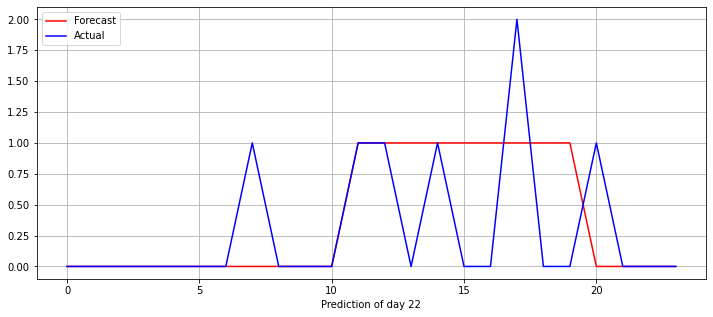

In [171]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)

#### Estación 31611

In [172]:
X_train, X_validation, X_test, Y_train, Y_validation, Y_test = getTrainValidationTestStationT24T48T168_ExogVariables(4000, 102, '31611', completeRentalsDf, completeWeatherDf)

Shape del dataframe 'X_train' --> (4000, 24, 5) // 'X_validation --> (102, 24, 5) //  X_test --> (102, 24, 5)
Shape del dataframe 'Y_train' --> (4000, 24) // 'Y_validation --> (102, 24) // Y_test --> (102, 24)


In [173]:
model = Sequential()
model.add(LSTM(X_train.shape[1], input_shape=(X_train.shape[1], 5), return_sequences=True, name='LSTM_1'))
model.add(TimeDistributed(Dense(16, activation="relu", name="Dense_1")))
model.add(Dense(8, activation='relu', name='Dense_2'))
model.add(Dense(4, activation='relu', name='Dense_3'))
model.add(Dense(2, activation='relu', name='Dense_4'))
model.add(Dense(1, activation='relu', name='Dense_5'))
model.compile(loss='mean_squared_error', optimizer='adamax', metrics=['mae'])
print(model.summary())

Model: "sequential_32"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
LSTM_1 (LSTM)                (None, 24, 24)            2880      
_________________________________________________________________
time_distributed_32 (TimeDis (None, 24, 16)            400       
_________________________________________________________________
Dense_2 (Dense)              (None, 24, 8)             136       
_________________________________________________________________
Dense_3 (Dense)              (None, 24, 4)             36        
_________________________________________________________________
Dense_4 (Dense)              (None, 24, 2)             10        
_________________________________________________________________
Dense_5 (Dense)              (None, 24, 1)             3         
Total params: 3,465
Trainable params: 3,465
Non-trainable params: 0
___________________________________________________

In [174]:
with tf.device('/GPU:0'):
    model.fit(X_train, Y_train.reshape(Y_train.shape[0], Y_train.shape[1], 1), batch_size=batch_size, epochs=epochs)

Epoch 1/10000
1/1 [==============================] - 1s 1s/step - loss: 0.8302 - mae: 0.6143
Epoch 2/10000
1/1 [==============================] - 0s 37ms/step - loss: 0.8295 - mae: 0.6142
Epoch 3/10000
1/1 [==============================] - 0s 43ms/step - loss: 0.8289 - mae: 0.6141
Epoch 4/10000
1/1 [==============================] - 0s 47ms/step - loss: 0.8281 - mae: 0.6140
Epoch 5/10000
1/1 [==============================] - 0s 44ms/step - loss: 0.8272 - mae: 0.6139
Epoch 6/10000
1/1 [==============================] - 0s 42ms/step - loss: 0.8262 - mae: 0.6139
Epoch 7/10000
1/1 [==============================] - 0s 21ms/step - loss: 0.8250 - mae: 0.6138
Epoch 8/10000
1/1 [==============================] - 0s 12ms/step - loss: 0.8238 - mae: 0.6138
Epoch 9/10000
1/1 [==============================] - 0s 9ms/step - loss: 0.8224 - mae: 0.6138
Epoch 10/10000
1/1 [==============================] - 0s 11ms/step - loss: 0.8209 - mae: 0.6138
Epoch 11/10000
1/1 [==============================] 

In [177]:
score = model.evaluate(X_validation, Y_validation.reshape(Y_validation.shape[0], Y_validation.shape[1], 1), batch_size=batch_size, verbose=0)
for i,metric in enumerate(model.metrics_names):
    if (metric =='loss'): print(' Test rmse: {}'.format( math.sqrt(score[i])))
    print(' Test {}: {}'.format(metric, score[i]))
predictions = model.predict(x=X_validation, batch_size=batch_size, verbose=0).reshape(-1, 24)
log1p_mse_rmse(Y_validation, predictions)

 Test rmse: 0.5068478445076697
 Test loss: 0.2568947374820709
 Test mae: 0.39052098989486694
MSE = 2.170750856399536, RMSE = 1.473346821491646


MSE = 1.1448330879211426, RMSE = 1.069968732216574


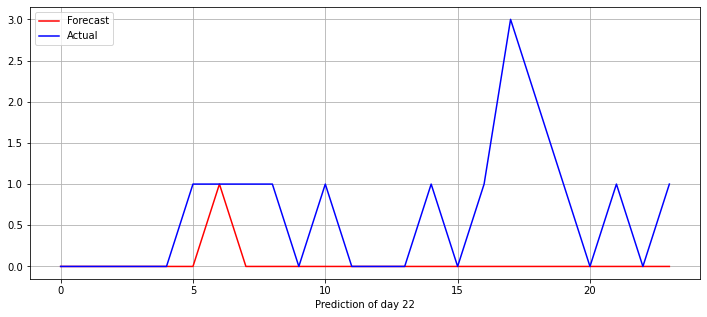

In [178]:
predictions = model.predict(x=X_test, batch_size=batch_size, verbose=0).reshape(-1,24)
log1p_mse_rmse(Y_test, predictions)
plotDayPrediction(predictions, Y_test, 22, True)